# Spark期末作业
## 读取数据

In [3]:
import pandas as pd
import numpy as np

rawData = pd.read_csv('./earthquake.csv', index_col = None)
rawData.head(10)

,Date,Time,Latitude,Longitude,Type,Depth,Magnitude
0,01/02/1965,13:44:18,19.246,145.616,Earthquake,131.6,6.0
1,01/04/1965,11:29:49,1.863,127.352,Earthquake,80.0,5.8
2,01/05/1965,18:05:58,-20.579,-173.972,Earthquake,20.0,6.2
3,01/08/1965,18:49:43,-59.076,-23.557,Earthquake,15.0,5.8
4,01/09/1965,13:32:50,11.938,126.427,Earthquake,15.0,5.8
5,01/10/1965,13:36:32,-13.405,166.629,Earthquake,35.0,6.7
6,01/12/1965,13:32:25,27.357,87.867,Earthquake,20.0,5.9
7,01/15/1965,23:17:42,-13.309,166.212,Earthquake,35.0,6.0
8,01/16/1965,11:32:37,-56.452,-27.043,Earthquake,95.0,6.0
9,01/17/1965,10:43:17,-24.563,178.487,Earthquake,565.0,5.8


In [2]:
rawData.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23412 entries, 0 to 23411
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Date       23412 non-null  object 
 1   Time       23412 non-null  object 
 2   Latitude   23412 non-null  float64
 3   Longitude  23412 non-null  float64
 4   Type       23412 non-null  object 
 5   Depth      23412 non-null  float64
 6   Magnitude  23412 non-null  float64
dtypes: float64(4), object(3)
memory usage: 1.3+ MB


## 清洗数据
这些属性都没有缺失值，但还存在一些格式不一致的现象，需要进行格式转换。
### 清洗Date数据
Pandas提供了to_datetime()方法，可以将不同的日期格式转换为datetime 类型。设置errors='coerce'参数，遇到不能转换的格式时将其置为NaN。

In [3]:
rawData['Structed Date'] = pd.to_datetime(rawData['Date'], 
                                          format = "%m/%d/%Y", 
                                          errors='coerce').dt.date
rawData['Structed Date'].loc[rawData['Structed Date'].isnull()]

3378     NaT
7512     NaT
20650    NaT
Name: Structed Date, dtype: object

In [4]:
rawData['Date'].loc[[3378,7512,20650]]

3378     1975-02-23T02:58:41.000Z
7512     1985-04-28T02:53:41.530Z
20650    2011-03-13T02:23:34.520Z
Name: Date, dtype: object

In [5]:
rawData.loc[3378, 'Structed Date'] = '1975-02-23'
rawData.loc[7512, 'Structed Date'] = '1985-04-28'
rawData.loc[20650, 'Structed Date'] = '2011-03-13'

In [6]:
del rawData['Date']

### 清洗Time数据

In [7]:
# 对时间进行格式转换
rawData['Structed Time'] = pd.to_datetime(rawData['Time'], 
                                          format = "%H:%M:%S", 
                                          errors='coerce').dt.time
rawData['Structed Time'].loc[rawData['Structed Time'].isnull()]

3378     NaT
7512     NaT
20650    NaT
Name: Structed Time, dtype: object

In [8]:
rawData['Time'].loc[[3378,7512,20650]]

3378     1975-02-23T02:58:41.000Z
7512     1985-04-28T02:53:41.530Z
20650    2011-03-13T02:23:34.520Z
Name: Time, dtype: object

In [9]:
rawData.loc[3378, 'Structed Time'] = '2:58:41'
rawData.loc[7512, 'Structed Time'] = '2:53:41'
rawData.loc[20650, 'Structed Time'] = '2:23:34'

In [10]:
del rawData['Time']

修改完成后，将列名重新改回Date和Time。

In [11]:
rawData.rename(columns={'Structed Date': 'Date', 'Structed Time': 'Time'}, 
               inplace=True)
rawData.head(10)

,Latitude,Longitude,Type,Depth,Magnitude,Date,Time
0,19.246,145.616,Earthquake,131.6,6.0,1965-01-02,13:44:18
1,1.863,127.352,Earthquake,80.0,5.8,1965-01-04,11:29:49
2,-20.579,-173.972,Earthquake,20.0,6.2,1965-01-05,18:05:58
3,-59.076,-23.557,Earthquake,15.0,5.8,1965-01-08,18:49:43
4,11.938,126.427,Earthquake,15.0,5.8,1965-01-09,13:32:50
5,-13.405,166.629,Earthquake,35.0,6.7,1965-01-10,13:36:32
6,27.357,87.867,Earthquake,20.0,5.9,1965-01-12,13:32:25
7,-13.309,166.212,Earthquake,35.0,6.0,1965-01-15,23:17:42
8,-56.452,-27.043,Earthquake,95.0,6.0,1965-01-16,11:32:37
9,-24.563,178.487,Earthquake,565.0,5.8,1965-01-17,10:43:17


### 根据经纬度获取地名
高德地图的逆地理编码API服务可以根据经纬度查询出该位置的地名信息。经过测试，这个API对于中国境外的坐标常常不能准确地返回结果，因此只获取在中国境内的坐标信息。坐标在中国境外时，就返回一个空值。如果坐标在海上，就获取海域的名称（如南海）；如果在陆地上，就获取省份的名称。

In [12]:
import requests
import json

def getProvince(lon, lat):
    u1 = 'http://restapi.amap.com/v3/geocode/regeo?output=json&'
    key = '&key=c8a747ca0df252b682af24300c69ba76'
    location = 'location=' + str(lon) + ','+ str(lat)
    url = u1 + location + key
    res = requests.get(url)
    json_data = json.loads(res.text)
    regeoinfo = json_data['regeocode']['addressComponent']
    
    if 'country' in regeoinfo and regeoinfo['country'] == '中国':
        if 'province' in regeoinfo and regeoinfo['province']:
            return regeoinfo['province']
        elif 'seaArea' in regeoinfo and regeoinfo['seaArea']:
            return regeoinfo['seaArea']
    
    return None

为每个经纬度坐标获取位置信息，需要花费十分钟左右的时间。

In [13]:
for i in range(23412):
    lon = rawData.loc[i, 'Longitude']
    lat = rawData.loc[i, 'Latitude']
    rawData.loc[i, 'Area'] = getProvince(lon, lat)

In [14]:
rawData["Area"].unique()

array([nan, '南海', None, '东海', '新疆维吾尔自治区', '西藏自治区', '台湾省', '云南省', '河北省',
       '四川省', '青海省', '渤海', '广东省', '江苏省', '辽宁省', '内蒙古自治区', '天津市', '黑龙江省',
       '山东省', '甘肃省', '黄海', '山西省', '吉林省', '贵州省'], dtype=object)

In [15]:
rawData.loc[rawData.Area.notnull()].sample(5)

,Latitude,Longitude,Type,Depth,Magnitude,Date,Time,Area
10300,23.7660,121.5920,Earthquake,17.7,5.9,1990-12-25,14:21:53,东海
18843,32.3490,85.2620,Earthquake,5.4,5.5,2008-01-22,18:43:33,西藏自治区
23355,39.2732,73.9776,Earthquake,17.0,6.6,2016-11-25,14:24:31,新疆维吾尔自治区
15424,24.5130,122.0330,Earthquake,32.1,5.9,2001-06-14,02:35:26,东海
18834,32.3310,85.1580,Earthquake,9.0,5.9,2008-01-16,11:54:44,西藏自治区


查看Type属性中是否有异常。

In [16]:
rawData.Type.unique()

array(['Earthquake', 'Nuclear Explosion', 'Explosion', 'Rock Burst'],
      dtype=object)

至此，数据清洗工作完成。将数据保存到文件earthquake_cleaned.csv中，编码设为utf-8，防止spark读取的时候出现中文乱码。

In [17]:
rawData.to_csv("earthquake_cleaned.csv", 
               encoding='utf-8', 
               index=False)

将其上传到HDFS，以便Spark对其进行数据分析。
## 数据分析


In [18]:
from pyspark import SparkContext,SparkConf
from pyspark.sql import SparkSession
spark = SparkSession.builder.config(conf = SparkConf()).getOrCreate()

In [19]:
df = spark.read.csv("input/earthquake_cleaned.csv", 
                    header=True, 
                    inferSchema=True)
df = df.repartition(1)
df.show(10)

+-------------------+-------------------+----------+-----+---------+-------------------+--------+----+
|           Latitude|          Longitude|      Type|Depth|Magnitude|               Date|    Time|Area|
+-------------------+-------------------+----------+-----+---------+-------------------+--------+----+
|             19.246|            145.616|Earthquake|131.6|      6.0|1965-01-02 00:00:00|13:44:18|null|
| 1.8630000000000002|            127.352|Earthquake| 80.0|      5.8|1965-01-04 00:00:00|11:29:49|null|
|            -20.579|           -173.972|Earthquake| 20.0|      6.2|1965-01-05 00:00:00|18:05:58|null|
|            -59.076|            -23.557|Earthquake| 15.0|      5.8|1965-01-08 00:00:00|18:49:43|null|
| 11.937999999999999|            126.427|Earthquake| 15.0|      5.8|1965-01-09 00:00:00|13:32:50|null|
|            -13.405| 166.62900000000002|Earthquake| 35.0|      6.7|1965-01-10 00:00:00|13:36:32|null|
|             27.357|             87.867|Earthquake| 20.0|      5.9|1965-

显示数据部分行后发现Spark读取csv文件时将Date列读取成了1965-01-02 00:00:00的格式，因此还需要进一步对数据进行处理。对Date属性进行拆分，丢掉后面00:00:00的部分。

In [20]:
from pyspark.sql.functions import split

df = df.withColumn("newDate", 
                   split(df['Date'], " ")[0]).drop("Date")
df.show(10)

+-------------------+-------------------+----------+-----+---------+--------+----+----------+
|           Latitude|          Longitude|      Type|Depth|Magnitude|    Time|Area|   newDate|
+-------------------+-------------------+----------+-----+---------+--------+----+----------+
|             19.246|            145.616|Earthquake|131.6|      6.0|13:44:18|null|1965-01-02|
| 1.8630000000000002|            127.352|Earthquake| 80.0|      5.8|11:29:49|null|1965-01-04|
|            -20.579|           -173.972|Earthquake| 20.0|      6.2|18:05:58|null|1965-01-05|
|            -59.076|            -23.557|Earthquake| 15.0|      5.8|18:49:43|null|1965-01-08|
| 11.937999999999999|            126.427|Earthquake| 15.0|      5.8|13:32:50|null|1965-01-09|
|            -13.405| 166.62900000000002|Earthquake| 35.0|      6.7|13:36:32|null|1965-01-10|
|             27.357|             87.867|Earthquake| 20.0|      5.9|13:32:25|null|1965-01-12|
|-13.309000000000001| 166.21200000000002|Earthquake| 35.0|  

这里将newDate命名为Date，这样数据就跟一开始预期的样子相一致了。

In [21]:
df = df.withColumnRenamed("newDate", "Date")
df.show(10)

+-------------------+-------------------+----------+-----+---------+--------+----+----------+
|           Latitude|          Longitude|      Type|Depth|Magnitude|    Time|Area|      Date|
+-------------------+-------------------+----------+-----+---------+--------+----+----------+
|             19.246|            145.616|Earthquake|131.6|      6.0|13:44:18|null|1965-01-02|
| 1.8630000000000002|            127.352|Earthquake| 80.0|      5.8|11:29:49|null|1965-01-04|
|            -20.579|           -173.972|Earthquake| 20.0|      6.2|18:05:58|null|1965-01-05|
|            -59.076|            -23.557|Earthquake| 15.0|      5.8|18:49:43|null|1965-01-08|
| 11.937999999999999|            126.427|Earthquake| 15.0|      5.8|13:32:50|null|1965-01-09|
|            -13.405| 166.62900000000002|Earthquake| 35.0|      6.7|13:36:32|null|1965-01-10|
|             27.357|             87.867|Earthquake| 20.0|      5.9|13:32:25|null|1965-01-12|
|-13.309000000000001| 166.21200000000002|Earthquake| 35.0|  

### 将数据按年份、月份、日期计数
要完成这个目标就要对Date属性进行拆分，就能得到年月日的信息。

In [22]:
attrsName = ['Year', 'Month', 'Day']
for i in range(len(attrsName)):
    df = df.withColumn(attrsName[i], 
                       split(df['Date'], "-")[i])
df.show(10)

+-------------------+-------------------+----------+-----+---------+--------+----+----------+----+-----+---+
|           Latitude|          Longitude|      Type|Depth|Magnitude|    Time|Area|      Date|Year|Month|Day|
+-------------------+-------------------+----------+-----+---------+--------+----+----------+----+-----+---+
|             19.246|            145.616|Earthquake|131.6|      6.0|13:44:18|null|1965-01-02|1965|   01| 02|
| 1.8630000000000002|            127.352|Earthquake| 80.0|      5.8|11:29:49|null|1965-01-04|1965|   01| 04|
|            -20.579|           -173.972|Earthquake| 20.0|      6.2|18:05:58|null|1965-01-05|1965|   01| 05|
|            -59.076|            -23.557|Earthquake| 15.0|      5.8|18:49:43|null|1965-01-08|1965|   01| 08|
| 11.937999999999999|            126.427|Earthquake| 15.0|      5.8|13:32:50|null|1965-01-09|1965|   01| 09|
|            -13.405| 166.62900000000002|Earthquake| 35.0|      6.7|13:36:32|null|1965-01-10|1965|   01| 10|
|             27.35

In [23]:
df.printSchema()

root
 |-- Latitude: double (nullable = true)
 |-- Longitude: double (nullable = true)
 |-- Type: string (nullable = true)
 |-- Depth: double (nullable = true)
 |-- Magnitude: double (nullable = true)
 |-- Time: string (nullable = true)
 |-- Area: string (nullable = true)
 |-- Date: string (nullable = true)
 |-- Year: string (nullable = true)
 |-- Month: string (nullable = true)
 |-- Day: string (nullable = true)



此时年月日信息都是字符串类型，将其改为整型。

In [24]:
for x in attrsName:
    df = df.withColumn(x, df[x].cast('int'))

df.printSchema()

root
 |-- Latitude: double (nullable = true)
 |-- Longitude: double (nullable = true)
 |-- Type: string (nullable = true)
 |-- Depth: double (nullable = true)
 |-- Magnitude: double (nullable = true)
 |-- Time: string (nullable = true)
 |-- Area: string (nullable = true)
 |-- Date: string (nullable = true)
 |-- Year: integer (nullable = true)
 |-- Month: integer (nullable = true)
 |-- Day: integer (nullable = true)



In [25]:
df.show(10)

+-------------------+-------------------+----------+-----+---------+--------+----+----------+----+-----+---+
|           Latitude|          Longitude|      Type|Depth|Magnitude|    Time|Area|      Date|Year|Month|Day|
+-------------------+-------------------+----------+-----+---------+--------+----+----------+----+-----+---+
|             19.246|            145.616|Earthquake|131.6|      6.0|13:44:18|null|1965-01-02|1965|    1|  2|
| 1.8630000000000002|            127.352|Earthquake| 80.0|      5.8|11:29:49|null|1965-01-04|1965|    1|  4|
|            -20.579|           -173.972|Earthquake| 20.0|      6.2|18:05:58|null|1965-01-05|1965|    1|  5|
|            -59.076|            -23.557|Earthquake| 15.0|      5.8|18:49:43|null|1965-01-08|1965|    1|  8|
| 11.937999999999999|            126.427|Earthquake| 15.0|      5.8|13:32:50|null|1965-01-09|1965|    1|  9|
|            -13.405| 166.62900000000002|Earthquake| 35.0|      6.7|13:36:32|null|1965-01-10|1965|    1| 10|
|             27.35

In [26]:
countByYear = df.groupBy("Year").count().orderBy("Year")
countByYear.toPandas().to_csv("countByYear.csv", 
                              encoding='utf-8', 
                              index=False)
countByYear.show(10)

+----+-----+
|Year|count|
+----+-----+
|1965|  339|
|1966|  234|
|1967|  255|
|1968|  305|
|1969|  323|
|1970|  345|
|1971|  386|
|1972|  388|
|1973|  401|
|1974|  361|
+----+-----+
only showing top 10 rows



In [27]:
countByMonth = df.groupBy("Month").count().orderBy("Month")
countByMonth.toPandas().to_csv("countByMonth.csv", 
                               encoding='utf-8', 
                               index=False)
countByMonth.show(10)

+-----+-----+
|Month|count|
+-----+-----+
|    1| 1891|
|    2| 1829|
|    3| 2114|
|    4| 1971|
|    5| 1964|
|    6| 1824|
|    7| 1880|
|    8| 2014|
|    9| 1985|
|   10| 1952|
+-----+-----+
only showing top 10 rows



In [28]:
countByDay = df.groupBy("Day").count().orderBy("Day")
countByDay.toPandas().to_csv("countByDay.csv", 
                             encoding='utf-8', 
                             index=False)
countByDay.show(10)

+---+-----+
|Day|count|
+---+-----+
|  1|  773|
|  2|  706|
|  3|  782|
|  4|  732|
|  5|  769|
|  6|  746|
|  7|  783|
|  8|  732|
|  9|  714|
| 10|  766|
+---+-----+
only showing top 10 rows



### 每个省份（海域）发生重大地震的次数
首先筛选出发生在中国境内地震的数据，之后画图用。

In [29]:
earthquakeC = df.filter("Area is not null")
earthquakeC.toPandas().to_csv("earthquakeC.csv", 
                              encoding='utf-8', 
                              index=False)
earthquakeC.show(10)

+--------+------------------+----------+-----+---------+--------+----------------+----------+----+-----+---+
|Latitude|         Longitude|      Type|Depth|Magnitude|    Time|            Area|      Date|Year|Month|Day|
+--------+------------------+----------+-----+---------+--------+----------------+----------+----+-----+---+
|  21.104|121.21799999999999|Earthquake| 30.0|      5.7|08:18:57|            南海|1965-03-01|1965|    3|  1|
|  21.122|           121.148|Earthquake| 30.0|      5.6|13:20:57|            南海|1965-03-01|1965|    3|  1|
|  22.635|           121.117|Earthquake| 15.0|      5.8|02:02:09|            东海|1965-03-15|1965|    3| 15|
|   25.08|           122.897|Earthquake|165.0|      5.6|05:09:50|            东海|1965-04-15|1965|    4| 15|
|  21.045|120.79799999999999|Earthquake| 37.1|      6.1|22:15:45|            南海|1965-04-26|1965|    4| 26|
|  41.801|            79.414|Earthquake| 10.0|      6.2|08:34:43|新疆维吾尔自治区|1965-05-04|1965|    5|  4|
|  22.336|121.24799999999999|Earthqua

按Area属性对数据进行分组计数，要注意只筛选Area非空的数据。

In [30]:
countByArea = earthquakeC.groupBy("Area").count()
countByArea.toPandas().to_csv("countByArea.csv", 
                              encoding='utf-8', 
                              index=False)
countByArea.show(10)

+------------+-----+
|        Area|count|
+------------+-----+
|  西藏自治区|   72|
|      辽宁省|    1|
|        东海|  194|
|      河北省|   11|
|      台湾省|   49|
|        黄海|    2|
|      山西省|    1|
|内蒙古自治区|    6|
|      甘肃省|    9|
|      贵州省|    1|
+------------+-----+
only showing top 10 rows



### 不同类型地震的数量
分别计算出世界范围内和中国境内的不同地震类型的数量。

In [31]:
countByTypeC = earthquakeC.groupBy("Type").count()
countByTypeC.toPandas().to_csv("countByTypeC.csv", 
                               encoding='utf-8', 
                               index=False)
countByTypeC.show()

+-----------------+-----+
|             Type|count|
+-----------------+-----+
|Nuclear Explosion|   10|
|       Earthquake|  631|
+-----------------+-----+



In [32]:
countByType = df.groupBy("Type").count()
countByType.toPandas().to_csv("countByType.csv", 
                              encoding='utf-8', 
                              index=False)
countByType.show()

+-----------------+-----+
|             Type|count|
+-----------------+-----+
|        Explosion|    4|
|       Rock Burst|    1|
|Nuclear Explosion|  175|
|       Earthquake|23232|
+-----------------+-----+



### 震级前500的地震
根据震级进行降序排序，个人比较关注离现在更近的地震，因此再根据年份降序排列。由于使用take(500)之后返回一个RDD，其中每个元素都是Row对象。此时根据这个RDD生成DataFrame，再将其保存为csv文件。

In [33]:
mostPow = df.sort(df["Magnitude"].desc(), df["Year"].desc()).take(500)
mostPowDF = spark.createDataFrame(mostPow)
mostPowDF.toPandas().to_csv("mostPow.csv", 
                            encoding='utf-8', 
                            index=False)
mostPowDF.show(10)

+------------------+-----------------+----------+-----+---------+--------+----+----------+----+-----+---+
|          Latitude|        Longitude|      Type|Depth|Magnitude|    Time|Area|      Date|Year|Month|Day|
+------------------+-----------------+----------+-----+---------+--------+----+----------+----+-----+---+
|            38.297|          142.373|Earthquake| 29.0|      9.1|05:46:24|null|2011-03-11|2011|    3| 11|
|             3.295|95.98200000000001|Earthquake| 30.0|      9.1|00:58:53|null|2004-12-26|2004|   12| 26|
|           -36.122|          -72.898|Earthquake| 22.9|      8.8|06:34:12|null|2010-02-27|2010|    2| 27|
|51.251000000000005|          178.715|Earthquake| 30.3|      8.7|05:01:22|null|1965-02-04|1965|    2|  4|
|             2.327|93.06299999999999|Earthquake| 20.0|      8.6|08:38:37|null|2012-04-11|2012|    4| 11|
|             2.085|97.10799999999999|Earthquake| 30.0|      8.6|16:09:37|null|2005-03-28|2005|    3| 28|
|            -4.438|          101.367|Earthqua

### 震源深度前500的地震
这个步骤跟上面的差不多。区别在于当震源深度相同时，将震级更高的地震排在前面。

In [34]:
mostDeep = df.sort(df["Depth"].desc(), df["Magnitude"].desc()).take(500)
mostDeepDF = spark.createDataFrame(mostDeep)
mostDeepDF.toPandas().to_csv("mostDeep.csv", 
                             encoding='utf-8', 
                             index=False)
mostDeepDF.show(10)

+-------------------+-------------------+----------+-----+---------+--------+----+----------+----+-----+---+
|           Latitude|          Longitude|      Type|Depth|Magnitude|    Time|Area|      Date|Year|Month|Day|
+-------------------+-------------------+----------+-----+---------+--------+----+----------+----+-----+---+
|            -20.158|-179.16299999999998|Earthquake|700.0|      5.5|19:14:02|null|1985-10-22|1985|   10| 22|
|            -24.871| 178.56599999999997|Earthquake|691.6|      5.6|12:52:04|null|2002-08-19|2002|    8| 19|
|-19.875999999999998|-179.09799999999998|Earthquake|690.0|      5.7|02:29:10|null|1977-06-17|1977|    6| 17|
|            -19.406|           -179.315|Earthquake|688.0|      6.1|22:01:09|null|2007-05-06|2007|    5|  6|
|            -20.073|           -179.135|Earthquake|687.6|      6.0|17:02:20|null|2000-09-02|2000|    9|  2|
|-19.250999999999998|           -179.362|Earthquake|682.2|      5.6|00:24:48|null|2007-05-07|2007|    5|  7|
|              51.5

### 震级与震源深度的关系
把DataFrame中的Magnitude属性和Depth属性选出来存到csv文件中。

In [35]:
df.select(df["Magnitude"], df["Depth"]).toPandas().to_csv("powDeep.csv", 
                                                          encoding='utf-8', 
                                                          index=False)

数据分析基本完成，此时将df也保存到csv文件中，用于数据可视化。

In [36]:
df.toPandas().to_csv("earthquake1.csv", 
                     encoding='utf-8', 
                     index=False)

## 数据可视化
可视化工具使用plotly，可以绘制可交互的图表，并可以完美兼容Jupyter Notebook。另外，用WordCloud绘制词云。
### 数据总览
首先将所有数据绘制到地图上。根据我们的常识，地震震级越高，地震的破坏力呈几何级数上升。为了画出更直观的图，使用exp(Magnitude)/100作为每个坐标的大小。

In [37]:
import plotly.express as px
import plotly.io as pio

data = pd.read_csv('earthquake1.csv')

fig1 = px.scatter_geo(data,
                      color = data.Magnitude,
                      color_continuous_scale = px.colors.sequential.Inferno,
                      lon = data.Longitude,
                      lat = data.Latitude,
                      hover_name = data.Type,
                      hover_data = ["Longitude", 
                                    "Latitude",
                                    "Date", 
                                    "Time",
                                    "Magnitude",
                                    "Depth" 
                                   ],
                      size = np.exp(data.Magnitude)/100,
                      projection = "equirectangular",
                      title = '1965-2016年全球重大地震'
                      )
fig1.show()
pio.write_html(fig1, 'fig1.html')

可以很清楚地看到地震带的分布，重大地震也主要发生在地震带上。

plotly还可以实现以某个属性为帧生成动画。

In [38]:
fig2 = px.scatter_geo(data,
                      color = data.Magnitude,
                      color_continuous_scale = px.colors.sequential.Inferno,
                      lon = data.Longitude,
                      lat = data.Latitude,
                      animation_frame = data.Year,
                      hover_name = data.Type,
                      hover_data = ["Longitude", 
                                    "Latitude",
                                    "Date", 
                                    "Time",
                                    "Magnitude",
                                    "Depth" 
                                   ],
                      size = np.exp(data.Magnitude)/100,
                      projection = "equirectangular",
                      title = '1965-2016年全球重大地震'
                      )
fig2.show()
pio.write_html(fig2, 'fig2.html')

### 每年份、月份、天份发生重大地震的次数
根据这些数据画出柱状图。

In [39]:
cntByYear = pd.read_csv('countByYear.csv')

fig3 = px.bar(cntByYear,
              x = "Year",
              y = "count",
              text = "count", 
              title = '1965-2016年每年发生重大地震的次数'
             )
fig3.show()
pio.write_html(fig3, 'fig3.html')

前十多年的地震次数明显少于之后的，可能是早期地震监测技术比较落后的原因。

In [40]:
cntByMonth = pd.read_csv('countByMonth.csv')

fig4 = px.bar(cntByMonth,
              x = "Month",
              y = "count",
              text = "count", 
              title = '1965-2016年每月发生重大地震的次数'
             )
fig4.show()
pio.write_html(fig4, 'fig4.html')

每月发生的地震次数基本上一致。

In [41]:
cntByDay = pd.read_csv('countByDay.csv')

fig5 = px.bar(cntByDay,
              x = "Day",
              y = "count",
              text = "count", 
              title = '1965-2016年每个日期发生重大地震的次数'
             )
fig5.show()
pio.write_html(fig5, 'fig5.html')

由于有一半的月份没有31号，因此31号的次数明显较少。

### 1955-2016年中国境内不同省份的重大地震次数
首先画出中国境内地震数据的总览。

In [42]:
dataC = pd.read_csv('earthquakeC.csv')
dataC.head(10)

,Latitude,Longitude,Type,Depth,Magnitude,Time,Area,Date,Year,Month,Day
0,21.104,121.218,Earthquake,30.0,5.7,08:18:57,南海,1965-03-01,1965,3,1
1,21.122,121.148,Earthquake,30.0,5.6,13:20:57,南海,1965-03-01,1965,3,1
2,22.635,121.117,Earthquake,15.0,5.8,02:02:09,东海,1965-03-15,1965,3,15
3,25.080,122.897,Earthquake,165.0,5.6,05:09:50,东海,1965-04-15,1965,4,15
4,21.045,120.798,Earthquake,37.1,6.1,22:15:45,南海,1965-04-26,1965,4,26
5,41.801,79.414,Earthquake,10.0,6.2,08:34:43,新疆维吾尔自治区,1965-05-04,1965,5,4
6,22.336,121.248,Earthquake,68.4,6.7,17:19:33,东海,1965-05-17,1965,5,17
7,32.052,87.784,Earthquake,10.0,5.9,20:14:51,西藏自治区,1965-06-17,1965,6,17
8,23.764,121.560,Earthquake,40.0,5.9,11:36:14,台湾省,1965-06-27,1965,6,27
9,22.338,101.496,Earthquake,35.0,5.9,11:26:13,云南省,1965-07-03,1965,7,3


In [43]:
fig6 = px.scatter_geo(dataC,
                      color = dataC.Magnitude,
                      color_continuous_scale = px.colors.sequential.Inferno,
                      lon = dataC.Longitude,
                      lat = dataC.Latitude,
                      scope = 'asia',
                      center = {'lon': 105.73, 'lat': 29.6},
                      hover_name = dataC.Type,
                      hover_data = ["Longitude", 
                                    "Latitude",
                                    "Date", 
                                    "Time",
                                    "Magnitude",
                                    "Depth" 
                                   ],
                      size = np.exp(dataC.Magnitude)/100,
                      title = '1965-2016年中国境内重大地震'
                      )
fig6.show()
pio.write_html(fig6, 'fig6.html')

再根据每个省份（海域）的数据生成柱状图和词云图。

In [44]:
cntByArea = pd.read_csv('countByArea.csv')

fig7 = px.bar(cntByArea,
              x = "Area",
              y = "count",
              text = "count", 
              title = '1965-2016年各省份（海域）发生重大地震的次数'
             )
fig7.show()
pio.write_html(fig7, 'fig7.html')

生成词云图之前要记得下载一个中文字体，放入代码目录中，否则中文会出现乱码。

In [45]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

freq = dict(zip(cntByArea["Area"], cntByArea["count"]))

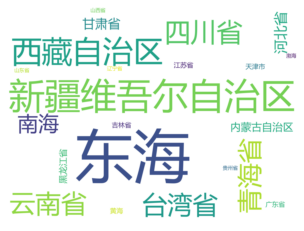

In [46]:
wc = WordCloud(font_path = "MSYH.TTC",
               prefer_horizontal = 0.7, 
               width = 800, 
               height = 600, 
               scale = 4,
               min_font_size = 10, 
               background_color = "white", 
               max_words = 30)
wc.generate_from_frequencies(freq)
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()
wc.to_file('wordcloud.png')

### 震级前500的重大地震

In [47]:
pow500 = pd.read_csv('mostPow.csv')

fig8 = px.scatter_geo(pow500,
                      color = pow500.Magnitude,
                      color_continuous_scale = px.colors.sequential.Inferno,
                      lon = pow500.Longitude,
                      lat = pow500.Latitude,
                      hover_name = pow500.Type,
                      hover_data = ["Longitude", 
                                    "Latitude",
                                    "Date", 
                                    "Time",
                                    "Magnitude",
                                    "Depth" 
                                   ],
                      size = np.exp(pow500.Magnitude)/100,
                      title = '1965-2016年震级前500的重大地震'
                      )
fig8.show()
pio.write_html(fig8, 'fig8.html')

### 震源深度前500的重大地震

In [48]:
deep500 = pd.read_csv('mostDeep.csv')

fig9 = px.scatter_geo(deep500,
                      color = deep500.Depth,
                      color_continuous_scale = px.colors.sequential.Inferno,
                      lon = deep500.Longitude,
                      lat = deep500.Latitude,
                      hover_name = deep500.Type,
                      hover_data = ["Longitude", 
                                    "Latitude",
                                    "Date", 
                                    "Time",
                                    "Magnitude",
                                    "Depth" 
                                   ],
                      title = '1965-2016年震源深度前500的重大地震'
                      )
fig9.show()
pio.write_html(fig9, 'fig9.html')

### 不同类型的地震
Type共有四个元素，如下：

In [49]:
cntByType = pd.read_csv('countByType.csv')
cntByType["Type"].unique()

array(['Explosion', 'Rock Burst', 'Nuclear Explosion', 'Earthquake'],
      dtype=object)

可以根据Type画出饼状图。

In [50]:
fig10 = px.pie(cntByType,
               names = "Type",
               values = "count",
               title = '1965-2016年世界范围内不同类型的地震占比'
              )
fig10.show()
pio.write_html(fig10, 'fig10.html')

可见99.2%是天然形成的地震，不到1%是核爆或者爆炸形成的。同样地也可以画出中国境内不同类型的地震占比。

In [51]:
cntByTypeC = pd.read_csv('countByTypeC.csv')

fig11 = px.pie(cntByTypeC,
               names = "Type",
               values = "count",
               title = '1965-2016年中国境内不同类型的地震占比'
              )
fig11.show()
pio.write_html(fig11, 'fig11.html')

### 震级和震源深度的关系

In [52]:
powAndDep = pd.read_csv('powDeep.csv')

fig12 = px.scatter(powAndDep,
                   x = "Depth",
                   y = "Magnitude",
                   title = '震级与震源深度的关系'
                  )
fig12.show()
pio.write_html(fig12, 'fig12.html')

可见震级8.0以上的地震大部分震源深度较浅，但从整体看地震的震级与震源深度的相关性不大。

至此数据可视化结束。